### Ruthuparna Naikar
### 002553734

In [ ]:
import os
import matplotlib.pyplot as plt
import numpy as npy
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
import os
import numpy as np
import io

Question 1) (20 points) Write a function that takes a List of five words: [‘apple’, ‘house’, ‘pear’,
‘dog’, ‘doctor’] and returns a list of lists with each element being a word and a list of the top five
most similar words. For this task you have to use the most suitable method of the ones we have
seen in class to determine the most similar words to the original input list. You can use a
pre-trained resource if you think is appropriate. After calling your function, print the most similar
words to the screen. Are these ‘similar’ words actually similar? If not, why not? What do you
think can be improved and how - talk about it, do not necessarily implement it?

In [ ]:
from gensim.models import KeyedVectors

!gdown --id 1hAw4QsjCoMM2ZQiYpknHWDMD1Ge8VP9W
!gunzip /content/GoogleNews-vectors-negative300.bin.gz
GNfile = '/content/GoogleNews-vectors-negative300.bin'

In [ ]:
model = KeyedVectors.load_word2vec_format(GNfile, binary=True, datatype=np.float16)

In [ ]:
def similar_words(words):
  list1 = []
  temp = []
  dt = {}

  for item in words:
    data = (model.most_similar(item))
    list1 = [i[0] for i in data]
    dt[item] = list1[:5]
  
  dt_list = list(dt.items())
  return dt_list

In [ ]:
words = ['apple' , 'house','pear','dog','doctor']
similar_words(words)

[['apple', ['apples', 'pear', 'fruit', 'berry', 'pears']],
 ['house', ['houses', 'bungalow', 'apartment', 'bedroom', 'townhouse']],
 ['pear', ['pears', 'apricot', 'apricots', 'nectarine', 'Fuji_apple']],
 ['dog', ['dogs', 'puppy', 'pit_bull', 'pooch', 'cat']],
 ['doctor', ['physician', 'doctors', 'gynecologist', 'surgeon', 'dentist']]]

The results of the functions are similar to the words we have provided. Although in my opinion this can be improved by re-running the same function on the word most similar to the given word.

Ex Running the same function on physician(most similar to doctor), we might get better results

Question 2) (30 points) Using the Homework 2 dataset, also attached in the Exam 2 files,
shakespeares-works_TXT_FolgerShakespeare.zip. Find the document to document similarity
using:
a) Cosine similarity. And create a 42 x 42 heatmap of these similarities.
b) Use Doc2Vec to create document embeddings and find the similarities between the
documents. To visualize this, also create a 42 x 42 heatmap for this.
c) What are the differences you find between the two methods? Is there anything radically
different? Please describe your answer in terms of the heatmap of part a and part b.

[[1.         0.63776982 0.59404353 ... 0.53550819 0.6751158  0.6896094 ]
 [0.63776982 1.         0.58879912 ... 0.53865387 0.68935089 0.68716882]
 [0.59404353 0.58879912 1.         ... 0.52581905 0.65190502 0.67148272]
 ...
 [0.53550819 0.53865387 0.52581905 ... 1.         0.59251467 0.6086646 ]
 [0.6751158  0.68935089 0.65190502 ... 0.59251467 1.         0.78910615]
 [0.6896094  0.68716882 0.67148272 ... 0.6086646  0.78910615 1.        ]]


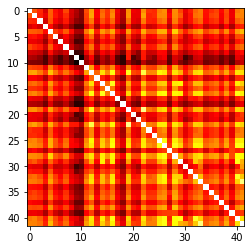

In [ ]:
path = '/content/drive/MyDrive/shakespeares-works'
txt = os.listdir(path)
document = []
for item in txt :  
  document.append(io.open(os.path.join(path,item),'r', encoding='utf8',errors='ignore').read())

TFIDF = TfidfVectorizer()
matrix = TFIDF.fit_transform(document)
cosine_sim = cosine_similarity(matrix,matrix)
print(cosine_sim)

plt.imshow(cosine_sim, cmap='hot', interpolation='nearest')
plt.show()

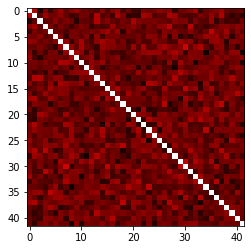

In [ ]:
from gensim.test.utils import common_texts
from gensim.models.doc2vec import Doc2Vec, TaggedDocument
tagged = [TaggedDocument(document, [i]) for i, doc in enumerate(document)]
model = Doc2Vec(tagged, vector_size=300, window=2, min_count=1, workers=4)

for i in range(0,300):
  data = model.docvecs[i]
  matrix.append(data)
plt.imshow(matrix, cmap='hot', interpolation='nearest')
plt.show()

#### What are the differences you find between the two methods? Is there anything radically different? Please describe your answer in terms of the heatmap of part a and part b.

Yes there is a difference. The Doc2Vec heatmap is more accuracte as they are not losely held int he grid.

Question 3) (30 points) Using the Homework 2 dataset. Use SpaCy to extract the following:
a) Write a function to generate all unique bigrams from all documents in the dataset. The
input of this function should be the concatenated dataset and the output should be the
list of bigrams and their frequency. Display the top 10 most common bigrams and their
frequency.
b) Write a function to generate all unique trigrams from all documents in the dataset. The
input of this function should be the concatenated dataset and the output should be the
list of trigrams and their frequency. Display the top 10 most common trigrams and their
frequency.
c) Write a function to extract all unique NOUN and VERB tokens. The input of this function
should be the concatenated dataset and the output should be two lists: one of the NOUN
tokens and their frequency, the other list should be the VERB tokens and their counts.
Display the top 10 most common NOUN and VERB tokens.
d) What do you think the most common bigrams and trigrams could be useful for? There is
a particular method we have seen in this class to characterize a corpus that could benefit
from having these bigrams/trigrams when the underlying text corpus can’t be shared.
Please talk about this.

In [ ]:
import  spacy 
nlp = spacy. load("en_core_web_sm")
from nltk import ngrams
import collections
import io

path = '/content/drive/MyDrive/NLP/shakespeares-works'
import os
txt = os.listdir(path)
document = []
for item in txt :  
  document.append(io.open(os.path.join(path,item),'r', encoding='utf8',errors='ignore').read())

doc_string = ""
doc_string = doc_string.join(document)

def bigrams(doc_string):
  sentence = doc_string
  bigrams = ngrams(sentence.split(), 2)
  bigram = collections.Counter(bigrams)
  bigram_list =[]
  bigram_list = list(bigram.items())
  return bigram_list

a = bigrams(doc_string)
sorted_bigrams = sorted(a, key=lambda x: x[1], reverse=True)


def trigrams(doc_string):
  sentence = doc_string
  trigram1 = ngrams(sentence.split(), 3)
  trigram = collections.Counter(trigram1)
  trigram_list =[]
  trigram_list = list(trigram.items())
  return trigram_list


a = trigrams(doc_string)
sorted_trigrams = sorted(a, key=lambda x: x[1], reverse=True)

[(('I', 'am'), 1832), (('in', 'the'), 1627), (('I', 'have'), 1622), (('I', 'will'), 1502), (('of', 'the'), 1443), (('to', 'the'), 1340), (('to', 'be'), 845), (('I', 'do'), 752), (('and', 'the'), 737), (('of', 'my'), 709)] [(('[They', 'exit.]', 'Scene'), 368), (('I', 'will', 'not'), 203), (('Scene', '1', '======='), 191), (('=====', 'Scene', '1'), 180), (('Scene', '2', '======='), 177), (('1', '=======', '[Enter'), 160), (('2', '=======', '[Enter'), 152), (('Scene', '3', '======='), 145), (('I', 'am', 'a'), 145), (('I', 'do', 'not'), 141)]


In [ ]:
print(sorted_bigrams[:10])

[(('I', 'am'), 1832), (('in', 'the'), 1627), (('I', 'have'), 1622), (('I', 'will'), 1502), (('of', 'the'), 1443), (('to', 'the'), 1340), (('to', 'be'), 845), (('I', 'do'), 752), (('and', 'the'), 737), (('of', 'my'), 709)]


In [ ]:
print(sorted_trigrams[:10])

[(('[They', 'exit.]', 'Scene'), 368), (('I', 'will', 'not'), 203), (('Scene', '1', '======='), 191), (('=====', 'Scene', '1'), 180), (('Scene', '2', '======='), 177), (('1', '=======', '[Enter'), 160), (('2', '=======', '[Enter'), 152), (('Scene', '3', '======='), 145), (('I', 'am', 'a'), 145), (('I', 'do', 'not'), 141)]


In [51]:
def nounverbs(doc):
  doc1 = nlp(doc)
  nouns = {}
  verbs = {}
  for token in doc1:
    if token.pos_== 'NOUN':
      if token not in nouns:
        nouns[token] = 1
      else:
        nouns[token] = nouns[token] + 1
    elif token.pos_== 'VERB':
      if token.text not in verbs:
        verb[token]= 1
      else:
        verb[token] = verb[token] + 1
      

  return nouns, verbs

##### What do you think the most common bigrams and trigrams could be useful for? There is a particular method we have seen in this class to characterize a corpus that could benefit from having these bigrams/trigrams when the underlying text corpus can’t be shared. Please talk about this.

- It helps in understanding the context as they can be used for next work prediction.

Ngrams are probablistic models useful in many NLP applications including speech recognition, machine translation and predictive text input.

The most common word bigrams/trigrams are used in search engines. In the class we have discussed about methods of generating ngrams 


Question 4) (30 points) Using the dataset: Ask0729, found in Exam files, write two functions to
extract all dates found in this dataset. The input of these functions should take the dataset as
input, and output a list of dates. You should use two different methods, one per function.
a) First method: using SpaCy (this is a big enough hint)
b) Second method: using regular expressions.
c) Print to screen to compare the results from the two functions.
d) Which one of the two approaches was better? Why do you think so? Would you use any
of these approaches? Or a different one?

In [39]:
with open('/content/Ask0729-fixed.txt', 'r') as file:
  doc_string = file.read()

In [48]:
def dates_spacy(doc_string):
  nlp.max_length = 5330337
  doc = nlp(doc_string)
  dates = []
  for token in doc.ents:
    if token.label_ == 'DATE':
      dates.append(token)
  return dates


# doc_string = ""
# doc_string = doc_string.join(document)
dates = dates_spacy(doc_string)

In [50]:
dates[:20]

[up to 5 years,
 today,
 today,
 today,
 one week,
 MA 02143,
 daily,
 today,
 3+ Nights & Save,
 this week,
 weekend,
 this week,
 2 Weeks,
 the year,
 tomorrow,
 Wednesday,
 Saturday,
 the 6 year old,
 tomorrow,
 25 years]

The approach using Spacy is perhaps better as regex is most hard-coded. Spacy implicitly categories all formats of dates both numeric and strings.
While regex is suitable for more generic structures of dates formats like dd/mm/yyyy or mm/dd/yy, Spacy is useful when we have a corpus with different date formats/ mentions.

Question 5) (30 points) Train an LSTM model to classify the Cornell Movie Review data using the polarity_dataset V2.0. You can use the code for class 19, but take a note that you will have to adapt some of the parameters like: Review size = 450, epochs=5. You will use 85% of the dataset for training, and 15% for testing. Once you build the model, please display the sklearn classification report. What are you noticing here? Anything unexpected? How does this model compare to the one built with the IMDB dataset in class? Any ideas on how to improve it?

In [14]:
!pip install numpy==1.16.2
import tensorflow as tf 
import numpy as np
from tensorflow.keras.preprocessing import sequence
from numpy import array
import logging
logging.getLogger('tensorflow').disabled = True

In [ ]:
!tar -xvf '/content/review_polarity.tar'

In [16]:
positive = []
negative = []
import os
for i in os.listdir('/content/txt_sentoken/neg'):
  filehandle = open(os.path.join('/content/txt_sentoken/neg',i),"r") 
  negative.append(filehandle.read())
for i in os.listdir('/content/txt_sentoken/pos'):
  filehandle = open(os.path.join('/content/txt_sentoken/pos',i),"r") 
  positive.append(filehandle.read())
combined = positive+negative
pos_label = []
neg_label = []
for i in range(len(positive)):
  pos_label.append(1)
for i in range(len(negative)):
  pos_label.append(0)
y = neg_label + pos_label

In [17]:
len(combined), len(y)

(2000, 2000)

In [5]:
#combing datasets to encode
# combined = X_train + X_test

In [18]:
#creating word_index
word_index = {}
word_index["<PAD>"] = 0
word_index["<START>"] = 1
word_index["<UNKNOWN>"] = 2
word_index["<UNUSED>"] = 3
# Because 0,1,2 and 3 are set above
num = 4

for item in combined:
    for x in item.split(' '):
        if x not in word_index:
            word_index[x] = num
            num = num+1
#creating the encoding
encoding = []
for i in combined:
    temp = []
    for word in i.split(' '):
        
        temp.append(word_index[word])
       
    encoding.append(temp)

In [19]:
#splitting from the encodings
from sklearn.model_selection import train_test_split
X_train_lstm, X_test_lstm, y_train_lstm, y_test_lstm = train_test_split(encoding,y ,test_size=0.15, random_state=12345)

In [20]:
from tensorflow.keras.preprocessing import sequence
enconding_padded = sequence.pad_sequences(encoding, maxlen = 450)

In [21]:
vocab_size = len(word_index)
review_length = 450

In [27]:
y_train_lstm = np.array(y_train_lstm)
y_test_lstm = np.array(y_test_lstm)
X_train_lstm = np.array(X_train_lstm)
X_test_lstm = np.array(X_test_lstm)

In [28]:
# Padding / truncated our reviews
X_train_lstm = sequence.pad_sequences(X_train_lstm, maxlen = review_length)
X_test_lstm = sequence.pad_sequences(X_test_lstm, maxlen = review_length)

# Check the size of our datasets. Review data for both test and training should 
# contain 25000 reviews of 500 integers. Class data should contain 25000 values, 
# one for each review. Class values are 0 or 1, indicating a negative 
# or positive review.
print("Shape Training Review Data: " + str(X_train_lstm.shape))
print("Shape Training Class Data: " + str(y_train_lstm.shape))
print("Shape Test Review Data: " + str(X_test_lstm.shape))
print("Shape Test Class Data: " + str(y_test_lstm.shape))

Shape Training Review Data: (1700, 450)
Shape Training Class Data: (1700,)
Shape Test Review Data: (300, 450)
Shape Test Class Data: (300,)


In [29]:
import tensorflow as tf
lstm = tf.keras.models.Sequential()

# The Embedding Layer provides a spatial mapping (or Word Embedding) of all the 
# individual words in our training set. Words close to one another share context 
# and or meaning. This spatial mapping is learning during the training process.
lstm.add(
    tf.keras.layers.Embedding(
        input_dim = vocab_size, # The size of our vocabulary 
        output_dim = 32, # Dimensions to which each words shall be mapped
        input_length = review_length # Length of input sequences
    )
)

# Dropout layers fight overfitting and forces the model to learn multiple 
# representations of the same data by randomly disabling neurons in the 
# learning phase.
lstm.add(
    tf.keras.layers.Dropout(
        rate=0.25 # Randomly disable 25% of neurons
    )
)

# We are using a fast version of LSTM whih is optimised for GPUs. This layer 
# looks at the sequence of words in the review, along with their word embeddings
# and uses both of these to determine to sentiment of a given review.
lstm.add(
    tf.keras.layers.LSTM(
        units=32 # 32 LSTM units in this layer
    )
)

# Add a second dropout layer with the same aim as the first.
lstm.add(
    tf.keras.layers.Dropout(
        rate=0.25 # Randomly disable 25% of neurons
    )
)

# All LSTM units are connected to a single node in the dense layer. A sigmoid 
# activation function determines the output from this node - a value 
# between 0 and 1. Closer to 0 indicates a negative review. Closer to 1 
# indicates a positive review.
lstm.add(
    tf.keras.layers.Dense(
        units=1, # Single unit
        activation='sigmoid' # Sigmoid activation function (output from 0 to 1)
    )
)

# Compile the model
lstm.compile(
    loss=tf.keras.losses.binary_crossentropy, # loss function
    optimizer=tf.keras.optimizers.Adam(), # optimiser function
    metrics=['accuracy']) # reporting metric

# Display a summary of the models structure
lstm.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_2 (Embedding)      (None, 450, 32)           1798496   
_________________________________________________________________
dropout_4 (Dropout)          (None, 450, 32)           0         
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                8320      
_________________________________________________________________
dropout_5 (Dropout)          (None, 32)                0         
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 33        
Total params: 1,806,849
Trainable params: 1,806,849
Non-trainable params: 0
_________________________________________________________________


In [30]:
# #changing 4 to 1 in y
# y = y.tolist()
# y = [1 if i==4 else 0 for i in y]
# y_train_lstm = np.array(y)

In [31]:
history = lstm.fit(

    # Training data : features (review) and classes (positive or negative)
    X_train_lstm, y_train_lstm,
                    
    # Number of samples to work through before updating the 
    # internal model parameters via back propagation. The 
    # higher the batch, the more memory you need.
    batch_size=256, 

    # An epoch is an iteration over the entire training data.
    epochs=5, 
    
    # The model will set apart his fraction of the training 
    # data, will not train on it, and will evaluate the loss
    # and any model metrics on this data at the end of 
    # each epoch.
    validation_split=0.2,
    verbose=1
)

Epoch 1/5
6/6 [==============================] - 31s 138ms/step - loss: 0.6931 - accuracy: 0.5098 - val_loss: 0.6928 - val_accuracy: 0.5088
Epoch 2/5
6/6 [==============================] - 0s 59ms/step - loss: 0.6925 - accuracy: 0.5093 - val_loss: 0.6925 - val_accuracy: 0.5088
Epoch 3/5
6/6 [==============================] - 0s 59ms/step - loss: 0.6908 - accuracy: 0.5316 - val_loss: 0.6919 - val_accuracy: 0.5088
Epoch 4/5
6/6 [==============================] - 0s 56ms/step - loss: 0.6884 - accuracy: 0.5443 - val_loss: 0.6906 - val_accuracy: 0.5206
Epoch 5/5
6/6 [==============================] - 0s 54ms/step - loss: 0.6818 - accuracy: 0.6006 - val_loss: 0.6870 - val_accuracy: 0.5441


In [36]:
# Get Model Predictions for test data
from sklearn.metrics import classification_report
predicted_classes = lstm.predict_classes(X_test_lstm)
print(classification_report(y_test_lstm, predicted_classes))

              precision    recall  f1-score   support

           0       0.48      1.00      0.65       136
           1       1.00      0.10      0.19       164

    accuracy                           0.51       300
   macro avg       0.74      0.55      0.42       300
weighted avg       0.76      0.51      0.40       300



/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


LSTM under performs when compared with ImBD date classification. The model can be improved by
1. Providing more training data
2. Making the classes more balanced
3. Training the model with more number of epochs

Question 6) (30 points) Use the train.txt file from the PubMed 20K RCT dataset(https://github.com/Franck-Dernoncourt/pubmed-rct/tree/master/PubMed_20k_RCT) fine-tune a BERT transformer (class 9 code). This task is a bit different as the one seen in class, here the source dataset has FIVE different classes: background, objective, method, result, and conclusion. Once the BERT model is fine-tuned, classify the: test.txt set. Please present the per-class classification report (accuracy, precision, recall, f1-score metrics). Also, present the global metrics - all classes (accuracy, precision, recall, f1-score metrics). Did you model beat the baseline results (https://arxiv.org/pdf/1710.06071.pdf)? What do you think you can do to improve it

In [ ]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
!gdown --id 1hAw4QsjCoMM2ZQiYpknHWDMD1Ge8VP9W
!gunzip /content/GoogleNews-vectors-negative300.bin.gz

Downloading...
From: https://drive.google.com/uc?id=1hAw4QsjCoMM2ZQiYpknHWDMD1Ge8VP9W
To: /content/GoogleNews-vectors-negative300.bin.gz
1.65GB [00:18, 88.8MB/s]


In [ ]:
import tensorflow as tf

# Get the GPU device name.
device_name = tf.test.gpu_device_name()

# The device name should look like the following:
if device_name == '/device:GPU:0':
    print('Found GPU at: {}'.format(device_name))
else:
    raise SystemError('GPU device not found')

Found GPU at: /device:GPU:0


In [ ]:
import torch

# If there's a GPU available...
if torch.cuda.is_available():    

    # Tell PyTorch to use the GPU.    
    device = torch.device("cuda")

    print('There are %d GPU(s) available.' % torch.cuda.device_count())

    print('We will use the GPU:', torch.cuda.get_device_name(0))

# If not...
else:
    print('No GPU available, using the CPU instead.')
    device = torch.device("cpu")

There are 1 GPU(s) available.
We will use the GPU: Tesla P100-PCIE-16GB


In [ ]:
!pip install transformers


In [ ]:
from transformers import BertTokenizer

# Load the BERT tokenizer.
print('Loading BERT tokenizer...')
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased', do_lower_case=True)

Loading BERT tokenizer...


In [3]:
train_file = open('train.txt', 'r')
train_file = train_file.read()
train_file

'###24293578\nOBJECTIVE\tTo investigate the efficacy of 6 weeks of daily low-dose oral prednisolone in improving pain , mobility , and systemic low-grade inflammation in the short term and whether the effect would be sustained at 12 weeks in older adults with moderate to severe knee osteoarthritis ( OA ) .\nMETHODS\tA total of 125 patients with primary knee OA were randomized 1:1 ; 63 received 7.5 mg/day of prednisolone and 62 received placebo for 6 weeks .\nMETHODS\tOutcome measures included pain reduction and improvement in function scores and systemic inflammation markers .\nMETHODS\tPain was assessed using the visual analog pain scale ( 0-100 mm ) .\nMETHODS\tSecondary outcome measures included the Western Ontario and McMaster Universities Osteoarthritis Index scores , patient global assessment ( PGA ) of the severity of knee OA , and 6-min walk distance ( 6MWD ) .\nMETHODS\tSerum levels of interleukin 1 ( IL-1 ) , IL-6 , tumor necrosis factor ( TNF ) - , and high-sensitivity C-rea

In [ ]:
X= []
y = []
labels = ['OBJECTIVE','METHODS','RESULTS','CONCLUSIONS','BACKGROUND']
for i in train_file.split('\n'):
  if(len(i.split('\t')) == 2):
    l, line = i.split('\t')
    # for i in labels:
    if l in labels:
      X.append(line)
      y.append(labels.index(l))

In [ ]:
sentences = X
labels = y

In [ ]:
# Tokenize all of the sentences and map the tokens to thier word IDs.
input_ids = []
attention_masks = []

# For every sentence...
for sent in sentences:
    # `encode_plus` will:
    #   (1) Tokenize the sentence.
    #   (2) Prepend the `[CLS]` token to the start.
    #   (3) Append the `[SEP]` token to the end.
    #   (4) Map tokens to their IDs.
    #   (5) Pad or truncate the sentence to `max_length`
    #   (6) Create attention masks for [PAD] tokens.
    encoded_dict = tokenizer.encode_plus(
                        sent,                      # Sentence to encode.
                        add_special_tokens = True, # Add '[CLS]' and '[SEP]'
                        max_length = 64,           # Pad & truncate all sentences.
                        pad_to_max_length = True,
                        return_attention_mask = True,   # Construct attn. masks.
                        return_tensors = 'pt',     # Return pytorch tensors.
                   )
    
    # Add the encoded sentence to the list.    
    input_ids.append(encoded_dict['input_ids'])
    
    # And its attention mask (simply differentiates padding from non-padding).
    attention_masks.append(encoded_dict['attention_mask'])

# Convert the lists into tensors.
input_ids = torch.cat(input_ids, dim=0)
attention_masks = torch.cat(attention_masks, dim=0)
labels = torch.tensor(labels)

# Print sentence 0, now as a list of IDs.
print('Original: ', sentences[0])
print('Token IDs:', input_ids[0])

/usr/local/lib/python3.7/dist-packages/transformers/tokenization_utils_base.py:2079: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  FutureWarning,


Original:  To investigate the efficacy of 6 weeks of daily low-dose oral prednisolone in improving pain , mobility , and systemic low-grade inflammation in the short term and whether the effect would be sustained at 12 weeks in older adults with moderate to severe knee osteoarthritis ( OA ) .
Token IDs: tensor([  101,  2000,  8556,  1996, 21150,  1997,  1020,  3134,  1997,  3679,
         2659,  1011, 13004,  8700,  3653,  2094,  8977, 12898,  2638,  1999,
         9229,  3255,  1010, 12969,  1010,  1998, 22575,  2659,  1011,  3694,
        21733,  1999,  1996,  2460,  2744,  1998,  3251,  1996,  3466,  2052,
         2022,  8760,  2012,  2260,  3134,  1999,  3080,  6001,  2007,  8777,
         2000,  5729,  6181,  9808,  2618, 10441, 15265, 14778,  2483,  1006,
         1051,  2050,  1007,   102])


In [ ]:
from torch.utils.data import TensorDataset, random_split

# Combine the training inputs into a TensorDataset.
dataset = TensorDataset(input_ids, attention_masks, labels)

# Create a 90-10 train-validation split.

# Calculate the number of samples to include in each set.
train_size = int(0.9 * len(dataset))
val_size = len(dataset) - train_size

# Divide the dataset by randomly selecting samples.
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

print('{:>5,} training samples'.format(train_size))
print('{:>5,} validation samples'.format(val_size))

162,036 training samples
18,004 validation samples


In [ ]:
from torch.utils.data import DataLoader, RandomSampler, SequentialSampler

# The DataLoader needs to know our batch size for training, so we specify it 
# here. For fine-tuning BERT on a specific task, the authors recommend a batch 
# size of 16 or 32.
batch_size = 32

# Create the DataLoaders for our training and validation sets.
# We'll take training samples in random order. 
train_dataloader = DataLoader(
            train_dataset,  # The training samples.
            sampler = RandomSampler(train_dataset), # Select batches randomly
            batch_size = batch_size # Trains with this batch size.
        )

# For validation the order doesn't matter, so we'll just read them sequentially.
validation_dataloader = DataLoader(
            val_dataset, # The validation samples.
            sampler = SequentialSampler(val_dataset), # Pull out batches sequentially.
            batch_size = batch_size # Evaluate with this batch size.
        )

In [ ]:
from transformers import BertForSequenceClassification, AdamW, BertConfig

# Load BertForSequenceClassification, the pretrained BERT model with a single 
# linear classification layer on top. 
model = BertForSequenceClassification.from_pretrained(
    "bert-base-uncased", # Use the 12-layer BERT model, with an uncased vocab.
    num_labels = 5, # The number of output labels--2 for binary classification.
                    # You can increase this for multi-class tasks.   
    output_attentions = False, # Whether the model returns attentions weights.
    output_hidden_states = False, # Whether the model returns all hidden-states.
)

# Tell pytorch to run this model on the GPU.
model.cuda()

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertForSequenceClassification: ['cls.predictions.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing BertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of BertForSequenceClassification were not initialized from the model checkpoint at

RuntimeError: ignored

In [ ]:
# Note: AdamW is a class from the huggingface library (as opposed to pytorch) 
# I believe the 'W' stands for 'Weight Decay fix"
optimizer = AdamW(model.parameters(),
                  lr = 2e-5, # args.learning_rate - default is 5e-5, our notebook had 2e-5
                  eps = 1e-8 # args.adam_epsilon  - default is 1e-8.
                )

In [ ]:
from transformers import get_linear_schedule_with_warmup

# Number of training epochs. The BERT authors recommend between 2 and 4. 
# We chose to run for 4, but we'll see later that this may be over-fitting the
# training data.
epochs = 4

# Total number of training steps is [number of batches] x [number of epochs]. 
# (Note that this is not the same as the number of training samples).
total_steps = len(train_dataloader) * epochs

# Create the learning rate scheduler.
scheduler = get_linear_schedule_with_warmup(optimizer, 
                                            num_warmup_steps = 0, # Default value in run_glue.py
                                            num_training_steps = total_steps)

In [ ]:
import numpy as np

# Function to calculate the accuracy of our predictions vs labels
def flat_accuracy(preds, labels):
    pred_flat = np.argmax(preds, axis=1).flatten()
    labels_flat = labels.flatten()
    return np.sum(pred_flat == labels_flat) / len(labels_flat)

In [ ]:
import time
import datetime

def format_time(elapsed):
    '''
    Takes a time in seconds and returns a string hh:mm:ss
    '''
    # Round to the nearest second.
    elapsed_rounded = int(round((elapsed)))
    
    # Format as hh:mm:ss
    return str(datetime.timedelta(seconds=elapsed_rounded))

In [ ]:
import random
import numpy as np

# This training code is based on the `run_glue.py` script here:
# https://github.com/huggingface/transformers/blob/5bfcd0485ece086ebcbed2d008813037968a9e58/examples/run_glue.py#L128

# Set the seed value all over the place to make this reproducible.
seed_val = 42

random.seed(seed_val)
np.random.seed(seed_val)
torch.manual_seed(seed_val)
torch.cuda.manual_seed_all(seed_val)

# We'll store a number of quantities such as training and validation loss, 
# validation accuracy, and timings.
training_stats = []

# Measure the total training time for the whole run.
total_t0 = time.time()

# For each epoch...
for epoch_i in range(0, epochs):
    
    # ========================================
    #               Training
    # ========================================
    
    # Perform one full pass over the training set.

    print("")
    print('======== Epoch {:} / {:} ========'.format(epoch_i + 1, epochs))
    print('Training...')

    # Measure how long the training epoch takes.
    t0 = time.time()

    # Reset the total loss for this epoch.
    total_train_loss = 0

    # Put the model into training mode. Don't be mislead--the call to 
    # `train` just changes the *mode*, it doesn't *perform* the training.
    # `dropout` and `batchnorm` layers behave differently during training
    # vs. test (source: https://stackoverflow.com/questions/51433378/what-does-model-train-do-in-pytorch)
    model.train()

    # For each batch of training data...
    for step, batch in enumerate(train_dataloader):

        # Progress update every 40 batches.
        if step % 40 == 0 and not step == 0:
            # Calculate elapsed time in minutes.
            elapsed = format_time(time.time() - t0)
            
            # Report progress.
            print('  Batch {:>5,}  of  {:>5,}.    Elapsed: {:}.'.format(step, len(train_dataloader), elapsed))

        # Unpack this training batch from our dataloader. 
        #
        # As we unpack the batch, we'll also copy each tensor to the GPU using the 
        # `to` method.
        #
        # `batch` contains three pytorch tensors:
        #   [0]: input ids 
        #   [1]: attention masks
        #   [2]: labels 
        b_input_ids = batch[0].to(device)
        b_input_mask = batch[1].to(device)
        b_labels = batch[2].to(device)

        # Always clear any previously calculated gradients before performing a
        # backward pass. PyTorch doesn't do this automatically because 
        # accumulating the gradients is "convenient while training RNNs". 
        # (source: https://stackoverflow.com/questions/48001598/why-do-we-need-to-call-zero-grad-in-pytorch)
        model.zero_grad()        

        # Perform a forward pass (evaluate the model on this training batch).
        # In PyTorch, calling `model` will in turn call the model's `forward` 
        # function and pass down the arguments. The `forward` function is 
        # documented here: 
        # https://huggingface.co/transformers/model_doc/bert.html#bertforsequenceclassification
        # The results are returned in a results object, documented here:
        # https://huggingface.co/transformers/main_classes/output.html#transformers.modeling_outputs.SequenceClassifierOutput
        # Specifically, we'll get the loss (because we provided labels) and the
        # "logits"--the model outputs prior to activation.
        result = model(b_input_ids, 
                       token_type_ids=None, 
                       attention_mask=b_input_mask, 
                       labels=b_labels,
                       return_dict=True)

        loss = result.loss
        logits = result.logits

        # Accumulate the training loss over all of the batches so that we can
        # calculate the average loss at the end. `loss` is a Tensor containing a
        # single value; the `.item()` function just returns the Python value 
        # from the tensor.
        total_train_loss += loss.item()

        # Perform a backward pass to calculate the gradients.
        loss.backward()

        # Clip the norm of the gradients to 1.0.
        # This is to help prevent the "exploding gradients" problem.
        torch.nn.utils.clip_grad_norm_(model.parameters(), 1.0)

        # Update parameters and take a step using the computed gradient.
        # The optimizer dictates the "update rule"--how the parameters are
        # modified based on their gradients, the learning rate, etc.
        optimizer.step()

        # Update the learning rate.
        scheduler.step()

    # Calculate the average loss over all of the batches.
    avg_train_loss = total_train_loss / len(train_dataloader)            
    
    # Measure how long this epoch took.
    training_time = format_time(time.time() - t0)

    print("")
    print("  Average training loss: {0:.2f}".format(avg_train_loss))
    print("  Training epcoh took: {:}".format(training_time))
        
    # ========================================
    #               Validation
    # ========================================
    # After the completion of each training epoch, measure our performance on
    # our validation set.

    print("")
    print("Running Validation...")

    t0 = time.time()

    # Put the model in evaluation mode--the dropout layers behave differently
    # during evaluation.
    model.eval()

    # Tracking variables 
    total_eval_accuracy = 0
    total_eval_loss = 0
    nb_eval_steps = 0

    # Evaluate data for one epoch
    for batch in validation_dataloader:
        
        # Unpack this training batch from our dataloader. 
        #
        # As we unpack the batch, we'll also copy each tensor to the GPU using 
        # the `to` method.
        #
        # `batch` contains three pytorch tensors:
        #   [0]: input ids 
        #   [1]: attention masks
        #   [2]: labels 
        b_input_ids = batch[0].to(device)
        b_input_mask = batch[1].to(device)
        b_labels = batch[2].to(device)
        
        # Tell pytorch not to bother with constructing the compute graph during
        # the forward pass, since this is only needed for backprop (training).
        with torch.no_grad():        

            # Forward pass, calculate logit predictions.
            # token_type_ids is the same as the "segment ids", which 
            # differentiates sentence 1 and 2 in 2-sentence tasks.
            result = model(b_input_ids, 
                           token_type_ids=None, 
                           attention_mask=b_input_mask,
                           labels=b_labels,
                           return_dict=True)

        # Get the loss and "logits" output by the model. The "logits" are the 
        # output values prior to applying an activation function like the 
        # softmax.
        loss = result.loss
        logits = result.logits
            
        # Accumulate the validation loss.
        total_eval_loss += loss.item()

        # Move logits and labels to CPU
        logits = logits.detach().cpu().numpy()
        label_ids = b_labels.to('cpu').numpy()

        # Calculate the accuracy for this batch of test sentences, and
        # accumulate it over all batches.
        total_eval_accuracy += flat_accuracy(logits, label_ids)
        

    # Report the final accuracy for this validation run.
    avg_val_accuracy = total_eval_accuracy / len(validation_dataloader)
    print("  Accuracy: {0:.2f}".format(avg_val_accuracy))

    # Calculate the average loss over all of the batches.
    avg_val_loss = total_eval_loss / len(validation_dataloader)
    
    # Measure how long the validation run took.
    validation_time = format_time(time.time() - t0)
    
    print("  Validation Loss: {0:.2f}".format(avg_val_loss))
    print("  Validation took: {:}".format(validation_time))

    # Record all statistics from this epoch.
    training_stats.append(
        {
            'epoch': epoch_i + 1,
            'Training Loss': avg_train_loss,
            'Valid. Loss': avg_val_loss,
            'Valid. Accur.': avg_val_accuracy,
            'Training Time': training_time,
            'Validation Time': validation_time
        }
    )

print("")
print("Training complete!")

print("Total training took {:} (h:mm:ss)".format(format_time(time.time()-total_t0)))


======== Epoch 1 / 4 ========
Training...


RuntimeError: ignored

In [ ]:
# Tokenize all of the sentences and map the tokens to thier word IDs.
input_ids = []
attention_masks = []

# For every sentence...
for sent in sentences:
    # `encode_plus` will:
    #   (1) Tokenize the sentence.
    #   (2) Prepend the `[CLS]` token to the start.
    #   (3) Append the `[SEP]` token to the end.
    #   (4) Map tokens to their IDs.
    #   (5) Pad or truncate the sentence to `max_length`
    #   (6) Create attention masks for [PAD] tokens.
    encoded_dict = tokenizer.encode_plus(
                        sent,                      # Sentence to encode.
                        add_special_tokens = True, # Add '[CLS]' and '[SEP]'
                        max_length = 64,           # Pad & truncate all sentences.
                        pad_to_max_length = True,
                        return_attention_mask = True,   # Construct attn. masks.
                        return_tensors = 'pt',     # Return pytorch tensors.
                   )
    
    # Add the encoded sentence to the list.    
    input_ids.append(encoded_dict['input_ids'])
    
    # And its attention mask (simply differentiates padding from non-padding).
    attention_masks.append(encoded_dict['attention_mask'])

# Convert the lists into tensors.
input_ids = torch.cat(input_ids, dim=0)
attention_masks = torch.cat(attention_masks, dim=0)
labels = torch.tensor(labels)

# Set the batch size.  
batch_size = 32  

# Create the DataLoader.
prediction_data = TensorDataset(input_ids, attention_masks, labels)
prediction_sampler = SequentialSampler(prediction_data)
prediction_dataloader = DataLoader(prediction_data, sampler=prediction_sampler, batch_size=batch_size)

In [ ]:
# Prediction on test set

print('Predicting labels for {:,} test sentences...'.format(len(input_ids)))

# Put model in evaluation mode
model.eval()

# Tracking variables 
predictions , true_labels = [], []

# Predict 
for batch in prediction_dataloader:
  # Add batch to GPU
  batch = tuple(t.to(device) for t in batch)
  
  # Unpack the inputs from our dataloader
  b_input_ids, b_input_mask, b_labels = batch
  
  # Telling the model not to compute or store gradients, saving memory and 
  # speeding up prediction
  with torch.no_grad():
      # Forward pass, calculate logit predictions.
      result = model(b_input_ids, 
                     token_type_ids=None, 
                     attention_mask=b_input_mask,
                     return_dict=True)

  logits = result.logits

  # Move logits and labels to CPU
  logits = logits.detach().cpu().numpy()
  label_ids = b_labels.to('cpu').numpy()
  
  # Store predictions and true labels
  predictions.append(logits)
  true_labels.append(label_ids)

print('    DONE.')

In [ ]:
from sklearn.metrics import matthews_corrcoef

matthews_set = []

# Evaluate each test batch using Matthew's correlation coefficient
print('Calculating Matthews Corr. Coef. for each batch...')

# For each input batch...
for i in range(len(true_labels)):
  
  # The predictions for this batch are a 2-column ndarray (one column for "0" 
  # and one column for "1"). Pick the label with the highest value and turn this
  # in to a list of 0s and 1s.
  pred_labels_i = np.argmax(predictions[i], axis=1).flatten()
  
  # Calculate and store the coef for this batch.  
  matthews = matthews_corrcoef(true_labels[i], pred_labels_i)                
  matthews_set.append(matthews)

Bonus Question: (50 points) Solve question 6 but instead for fine-tuning BERT, use: BioBert
(20 points) and BlueBERT (20 points) and compare the results of the three approaches in a
nice table. Answer the following questions: Did you model beat the baseline results
(https://arxiv.org/pdf/1710.06071.pdf)? What do you think you can do to improve it?